In [ ]:
# ! jupyter labextension list
# ! jupyter labextension install @jupyter-widgets/jupyterlab-manager jupyter-matplotlib
# ! jupyter nbextension enable --py widgetsnbextension
# !pip install ipympl

import pandas as pd 
import pypianoroll
import matplotlib.pyplot as plt
import re 

data_path = '../data/first-pass-classification'
style_df = pd.read_csv(f'{data_path}/style_generation_results.csv')

midi_file, seq_len, _, style, _ = style_df.iloc[0]

pattern = r'([A-Z])\((\d+)\)'
sections = re.findall(pattern, style)

# Optionally, define a color mapping for section labels.
color_map = {'A': 'tab:blue', 'B': 'tab:orange', 'C': 'tab:green', 'D': 'tab:red', 'E': 'tab:purple'}
midi_file_path = f"{data_path}/midi/{midi_file}"
pianoroll = pypianoroll.read(midi_file_path)

# Basic Visualization

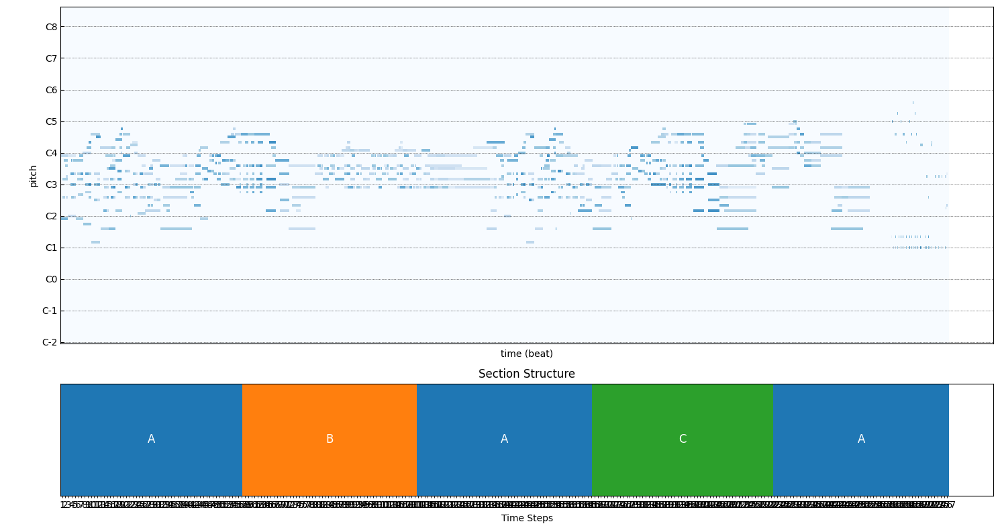

In [3]:
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(15, 8), sharex=True, gridspec_kw={'height_ratios': [3, 1]})
pianoroll.plot(axs=[ax1])

total_count = sum(list(map(lambda x: int(x[1]), sections)))
total_num_tempo_blocks = pianoroll.tempo.shape[0]
tempo_ratio = (total_num_tempo_blocks / total_count)

start = 0
for section, count_str in sections:
    count = int(count_str)
    normed_count = count * tempo_ratio
    color = color_map.get(section, 'tab:gray')
    ax2.broken_barh([(start, normed_count)], (0, 1), facecolors=color)
    ax2.text(start + normed_count/2, 0.5, section, va='center', ha='center', color='white', fontsize=12)
    start += normed_count

ax2.set_ylim(0, 1)
ax2.set_yticks([])
ax2.set_xticks([])
ax2.set_xticklabels([])
ax2.set_xlabel('Time Steps')
ax2.set_title('Section Structure')
plt.tight_layout()
plt.show()

# More complicated:

In [3]:
# ! pip install python-rtmidi
# ! pip install pygame
# ! pip install pydub

# directions to install fluidsynth
# brew install fluid-synth
# ! fluidsynth -ni ../soundfonts/FluidR3_GM.sf2 $midi_file_path -F output.wav -r 44100

# next, download this, put it in the project directory
# https://musical-artifacts.com/artifacts/738

Button(description='Play', style=ButtonStyle())

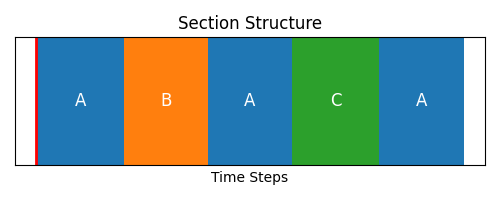

In [11]:
import ipywidgets as widgets
from IPython.display import display
import re
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
import pypianoroll
import matplotlib
%matplotlib widget
from pydub import AudioSegment

def get_wav_duration(wav_file):
    audio = AudioSegment.from_wav(wav_file)
    return len(audio) / 1000  # Convert milliseconds to seconds

wav_file = "output.wav"
wav_duration = get_wav_duration(wav_file)

fig, ax = plt.subplots(1, 1, figsize=(5, 2))

total_count = sum(int(x[1]) for x in sections)
tempo_ratio = wav_duration / total_count

# Plot the section structure
start = 0
for section, count_str in sections:
    count = int(count_str)
    normed_count = count * tempo_ratio
    color = color_map.get(section, 'gray')
    ax.broken_barh([(start, normed_count)], (0, 1), facecolors=color)
    ax.text(start + normed_count / 2, 0.5, section, va='center', ha='center', 
            color='white', fontsize=12)
    start += normed_count

ax.set_ylim(0, 1)
ax.set_yticks([])
ax.set_xticks([])
ax.set_xticklabels([])
ax.set_xlabel('Time Steps')
ax.set_title('Section Structure')

# Add play line
play_line = ax.axvline(x=0, color='red', linewidth=2)

# Animation parameters
fps = 30  # 30 frames per second
num_frames = int(wav_duration * fps)  # Total number of frames
interval = 1000 / fps  # Frame interval in milliseconds
is_playing = False  # Play state

# Initialization function
def init():
    play_line.set_xdata([0, 0])
    return play_line

# Update function
def update(frame):
    """Updates the playhead position based on the frame number."""
    if is_playing:
        current_time = frame / fps  # Convert frame index to seconds
        play_line.set_xdata([current_time, current_time])
    return play_line

# Create animation
ani = FuncAnimation(fig, update, frames=num_frames, init_func=init,
                    interval=interval, blit=True, repeat=False)

# Play/Pause Button
play_button = widgets.Button(description="Play")

def on_play_button_clicked(b):
    global is_playing
    is_playing = not is_playing
    play_button.description = "Pause" if is_playing else "Play"

play_button.on_click(on_play_button_clicked)
display(play_button)

plt.tight_layout()
plt.show()


In [10]:
from IPython.display import Audio
Audio("output.wav")

In [13]:
from IPython.display import HTML
audio_style = "<style>audio { margin-left: 35px; width: 1260px; }</style>"
display(HTML(audio_style))